In [1]:
!pip install supervision
!pip install peft
!pip install roboflow


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [2]:
import io
import os
import requests
import re
import json
import torch
import html
import base64
import itertools
import random

import numpy as np
import supervision as sv

from IPython.core.display import display, HTML
from torch.utils.data import Dataset, DataLoader
from transformers import (
    AdamW,
    AutoModelForCausalLM,
    AutoProcessor,
    get_scheduler
)
from tqdm import tqdm
from typing import List, Dict, Any, Tuple, Generator
from peft import LoraConfig, get_peft_model
from PIL import Image
from roboflow import Roboflow
from bs4 import BeautifulSoup

In [3]:
!pip install -q transformers flash_attn timm einops peft
!pip install -q roboflow git+https://github.com/roboflow/supervision.git


[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip

[notice] A new release of pip is available: 24.1.2 -> 24.2
[notice] To update, run: pip install --upgrade pip


In [4]:
!nvidia-smi

Mon Aug  5 21:45:20 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.183.06             Driver Version: 535.183.06   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      Off | 00000000:35:00.0 Off |                    0 |
| N/A   38C    P8              16W /  72W |      0MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Downloading the images

In [ ]:
google_image = "https://www.google.com/search?site=&tbm=isch&source=hp&biw=1873&bih=990&"

user_agent = {"User-Agent": "Mozilla/5.0 (Windows NT 6.1; WOW64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/43.0.2357.134 Safari/537.36"}

In [ ]:
def download_images(folder, categories, num_required):
  if not os.path.exists(folder):
    os.mkdir(folder)
  for category in categories:
    links = []
    search_url = google_image + 'q=' + category
    response = requests.get(search_url, headers=user_agent)
    html = response.text
    soup = BeautifulSoup(html, 'html.parser')
    results = soup.findAll('img', {'class': 'DS1iW'})
    count = 1
    for result in results:
        try:
            link = result['src']
            links.append(link)
            count += 1
            if(count > num_required):
                break
        except KeyError:
          continue
    for i, link in enumerate(links):
      response = requests.get(link)
      image_name = folder + '/' + category + '_' + str(i+1) + '.jpg'
      with open(image_name, 'wb') as fh:
          fh.write(response.content)

In [ ]:
categories = ["dogs", "cats"]
download_images('images', categories, 20)

After annotating via **Roboflow**

In [ ]:
rf = Roboflow(api_key="cRRTkEkCYliGBFa3bNTf")
project = rf.workspace("dhruv-gupta-dpgcz").project("task-florence2")
version = project.version(2)
dataset = version.download("florence2-od")

This dataset has 20 images of cats and 20 images of dogs. These have been scrapped from browser and an image may contain more than one cat or dog. 

# Loading the model

In [27]:
CHECKPOINT = "microsoft/Florence-2-base-ft"
REVISION = 'refs/pr/6'
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [28]:
model = AutoModelForCausalLM.from_pretrained(CHECKPOINT, trust_remote_code=True, revision=REVISION).to(DEVICE)
processor = AutoProcessor.from_pretrained(CHECKPOINT, trust_remote_code=True, revision=REVISION)

# Optimizing using LoRA

In [29]:
config = LoraConfig(
    r=8,
    lora_alpha=8,
    target_modules=["q_proj", "o_proj", "k_proj", "v_proj", "linear", "Conv2d", "lm_head", "fc2"],
    task_type="CAUSAL_LM",
    lora_dropout=0.05,
    bias="none",
    inference_mode=False,
    use_rslora=True,
    init_lora_weights="gaussian",
    revision=REVISION
)

peft_model = get_peft_model(model, config)
peft_model.print_trainable_parameters()

trainable params: 1,929,928 || all params: 272,733,896 || trainable%: 0.7076


# Changing Dataset format

In [8]:
class DetectionDataset(Dataset):
  def __init__(self, jsonl_file_path, image_directory_path):
    self.entries = []
    self.json_file_path = jsonl_file_path
    self.image_directory_path = image_directory_path
    with open(jsonl_file_path, 'r') as file:
      for line in file:
        data = json.loads(line)
        self.entries.append(data)

  def __len__(self):
    return len(self.entries)

  def __getitem__(self, index):
    entry = self.entries[index]
    image_path = os.path.join(self.image_directory_path, entry['image'])
    image = Image.open(image_path)
    return entry['prefix'], entry['suffix'], image

In [9]:
zero_shot_dataset = DetectionDataset("Task-Florence2-2/test/annotations.jsonl", "Task-Florence2-2/test")

# Zero Shot Performance of the model

In [10]:
def get_map_score(predictions, targets):
  mean_average_precision = sv.MeanAveragePrecision.from_detections(
      predictions=predictions,
      targets=targets,
  )

  print(f"map50_95: {mean_average_precision.map50_95:.2f}")
  print(f"map50: {mean_average_precision.map50:.2f}")
  print(f"map75: {mean_average_precision.map75:.2f}")

In [11]:
def get_confusion_matrix(predictions, targets, classes):
  confusion_matrix = sv.ConfusionMatrix.from_detections(
      predictions=predictions,
      targets=targets,
      classes=classes
  )
  confusion_matrix.plot()

In [24]:
def inference(model, dataset: DetectionDataset, classes):
  targets = []
  predictions = []
  for i in range(len(dataset)):
    prefix, suffix, image = dataset[i]
    inputs = processor(text=prefix, images=image, return_tensors="pt").to(DEVICE)
    generated_ids = model.generate(
        input_ids=inputs["input_ids"],
        pixel_values=inputs["pixel_values"],
        max_new_tokens=1024,
        num_beams=3
    )
    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=False)[0]

    prediction = processor.post_process_generation(generated_text, task='<OD>', image_size=image.size)
    target = processor.post_process_generation(suffix, task='<OD>', image_size=image.size)
      
    flag = 0
    if prediction["<OD>"]["labels"]!=target["<OD>"]["labels"]:
        flag = 1
    if flag==1:
      print("Predictions:", prediction["<OD>"]["labels"])
      print("Targets:", target["<OD>"]["labels"])
      detections = sv.Detections.from_lmm(sv.LMM.FLORENCE_2, prediction, resolution_wh=image.size)
      image = sv.BoundingBoxAnnotator(color_lookup=sv.ColorLookup.INDEX).annotate(image.copy(), detections)
      image = sv.LabelAnnotator(color_lookup=sv.ColorLookup.INDEX).annotate(image, detections)
      display(image)
      print()
        
    prediction = sv.Detections.from_lmm(sv.LMM.FLORENCE_2, prediction, resolution_wh=image.size)
    prediction = prediction[np.isin(prediction['class_name'], classes)]
    prediction.class_id = np.array([classes.index(class_name) for class_name in prediction['class_name']])
    prediction.confidence = np.ones(len(prediction))
      
    target = sv.Detections.from_lmm(sv.LMM.FLORENCE_2, target, resolution_wh=image.size)
    target.class_id = np.array([classes.index(class_name) for class_name in target['class_name']])

    targets.append(target)
    predictions.append(prediction)

  get_confusion_matrix(predictions, targets, classes)
  get_map_score(predictions, targets)

The images provided below are the ones that have differed from the ground truth. The predictions by model have been marked for better understanding. 

Predictions: ['cat', 'dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


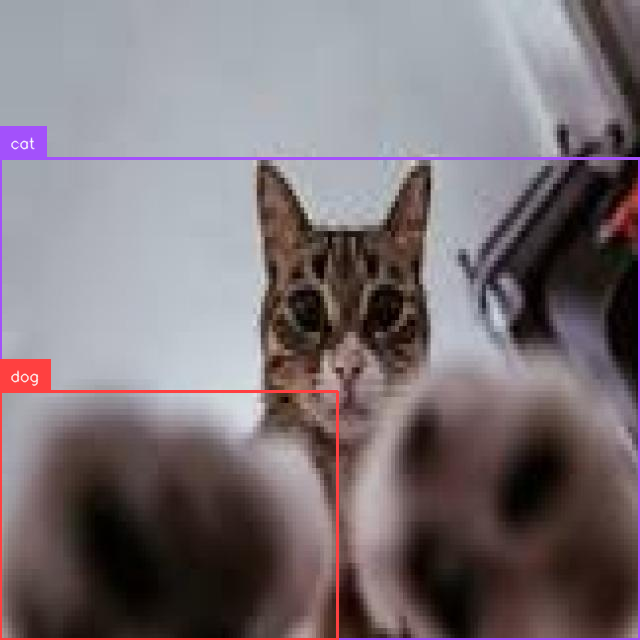


Predictions: ['dog']
Targets: ['dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


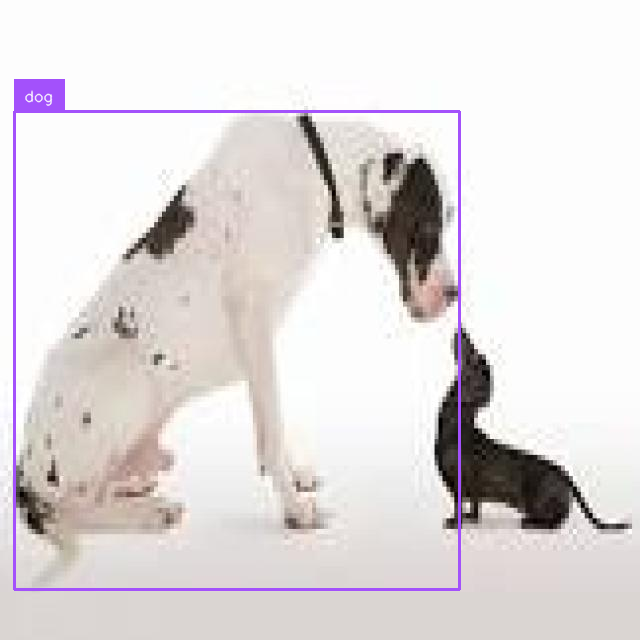


Predictions: ['carnivore']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


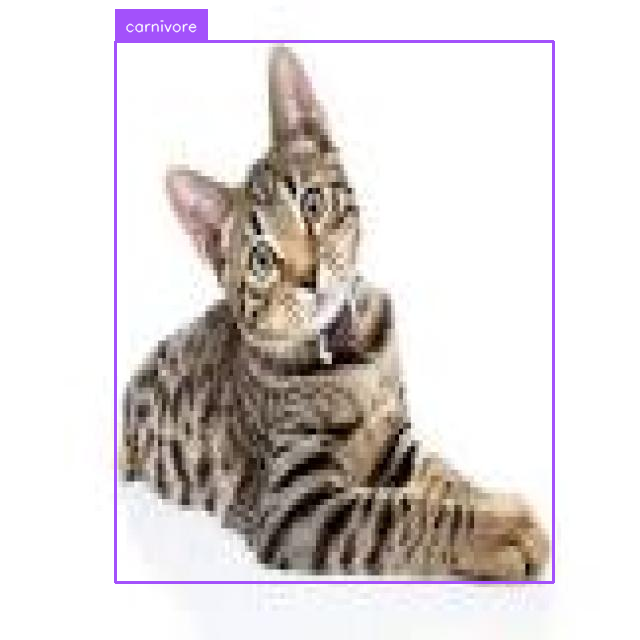


Predictions: ['carnivore']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


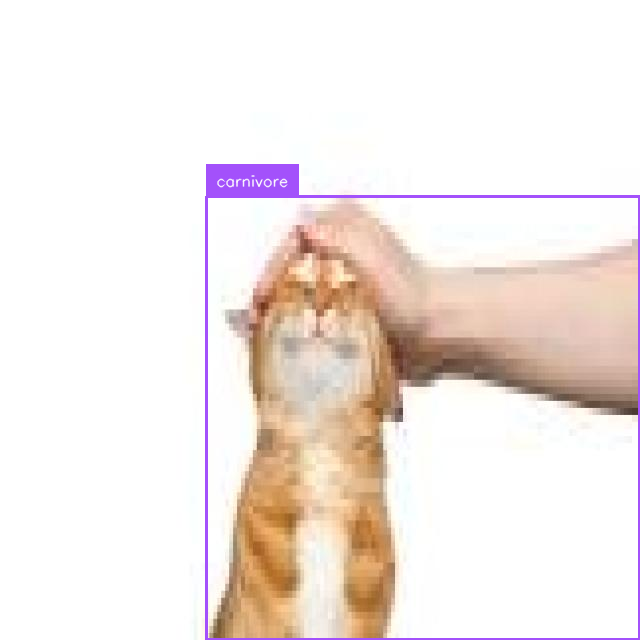


Predictions: ['cat', 'cat']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


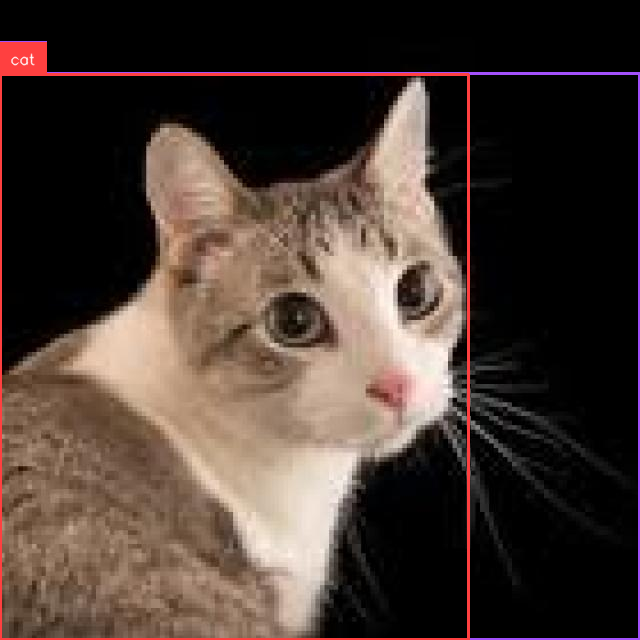


Predictions: ['dog']
Targets: ['cat', 'cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


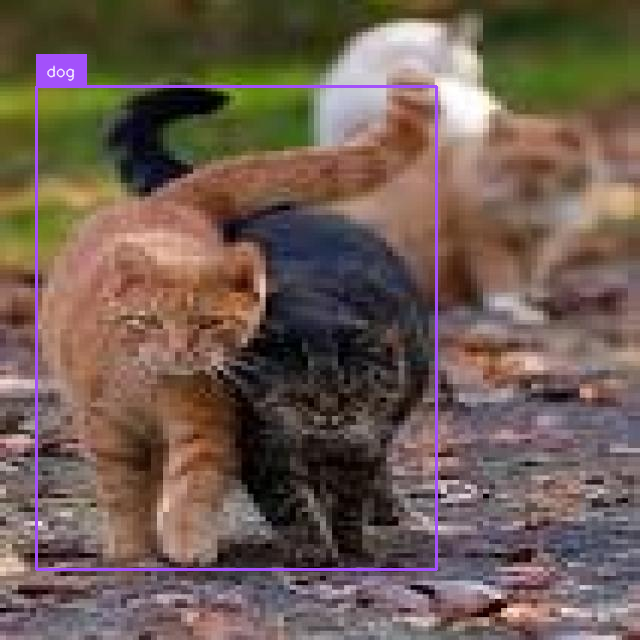


Predictions: ['dog']
Targets: ['dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


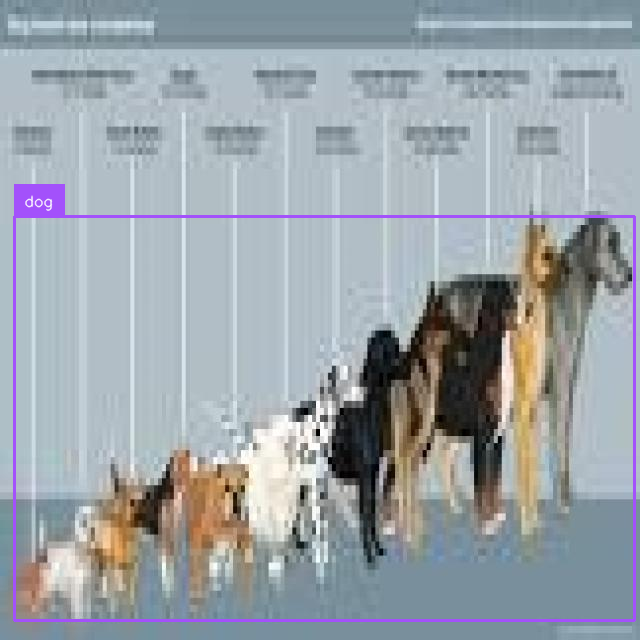


Predictions: ['carnivore']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


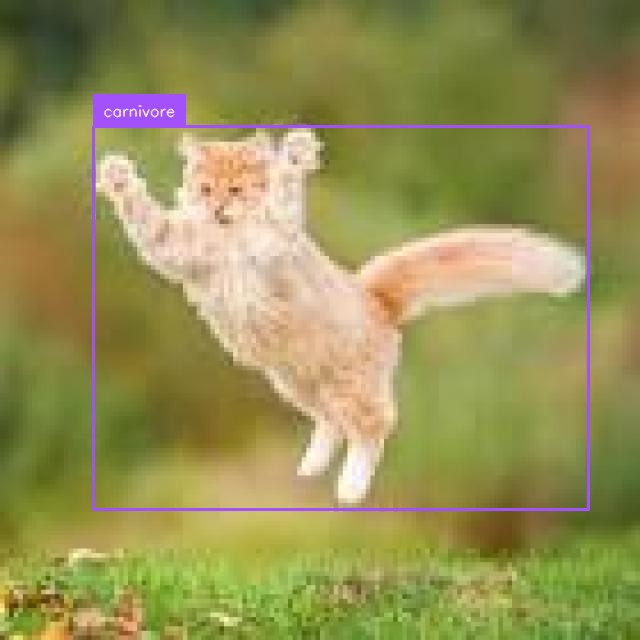


map50_95: 0.60
map50: 0.82
map75: 0.72


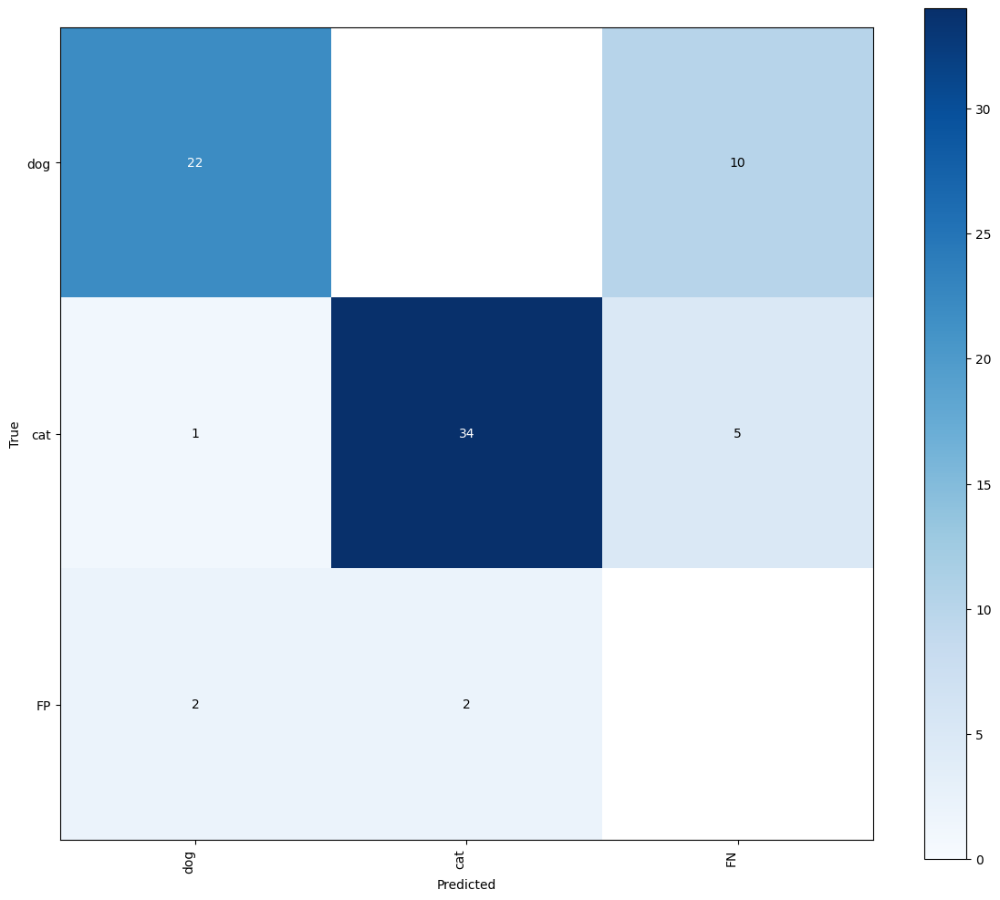

In [30]:
inference(peft_model, zero_shot_dataset, ["dog", "cat"])

The model is able to identify dogs and cats at most of the instances. 

But at some places the model uses some other more generic terms to describe the detected object like "carnivore". 

Also model was not able to identify all the dogs or cats if more than one was present in an image. This has increased the number of false negatives. 

# Finetuning the model

## Dataset Collectoin

In [ ]:
categories = ["black dog", "white dog", "small dog", "brown dog", "animated dog", "black cat", "white cat", "small cat", "brown cat", "animated cat"]
download_images("/content/drive/MyDrive/images_finetuning_50", categories, 10)

After annotating the images via roboflow

In [ ]:
rf = Roboflow(api_key="cRRTkEkCYliGBFa3bNTf")
project = rf.workspace("dhruv-gupta-dpgcz").project("florence2_fine_tuning")
version = project.version(3)
dataset = version.download("florence2-od")

This dataset has 100 images of which 50 are of cats and 50 of dogs. The dataset has been split into test and training set with a ratio of 6:4. The 50 images of an animal include 10 each of the following category: white, black, brown, small, animated. 

In [19]:
def collate_fn(batch):
  questions, answers, images = zip(*batch)
  inputs = processor(text=list(questions), images=list(images), return_tensors="pt", padding=True).to(DEVICE)
  return inputs, answers

In [20]:
train_dataset = DetectionDataset("Florence2_fine_tuning-3/train/annotations.jsonl", "Florence2_fine_tuning-3/train")
test_dataset = DetectionDataset("Florence2_fine_tuning-3/test/annotations.jsonl", "Florence2_fine_tuning-3/test")

train_loader = DataLoader(train_dataset, batch_size=6, collate_fn=collate_fn, num_workers=0, shuffle=True)


## Train Model

In [21]:
torch.cuda.empty_cache()

In [22]:
def train_model(model, train_loader, processor, epochs, learning_rate):
  optimizer = AdamW(model.parameters(), lr=learning_rate)
  num_training_steps = epochs * len(train_loader)
  lr_scheduler = get_scheduler(
      name="linear",
      optimizer=optimizer,
      num_warmup_steps=0,
      num_training_steps=num_training_steps,
  )

  model.train()

  for epoch in range(epochs):
    train_loss = 0
    for inputs, answers in tqdm(train_loader, desc=f"Training Epoch {epoch + 1}/{epochs}"):

        input_ids = inputs["input_ids"]
        pixel_values = inputs["pixel_values"]
        labels = processor.tokenizer(
            text=answers,
            return_tensors="pt",
            padding=True,
            return_token_type_ids=False
        ).input_ids.to(DEVICE)

        outputs = model(input_ids=input_ids, pixel_values=pixel_values, labels=labels)
        loss = outputs.loss

        loss.backward(), optimizer.step(), lr_scheduler.step(), optimizer.zero_grad()
        train_loss += loss.item()

    avg_train_loss = train_loss / len(train_loader)
    print(f"Average Training Loss: {avg_train_loss}")

In [23]:
train_model(peft_model, train_loader, processor, 15, 5e-6)

This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
Training Epoch 1/15: 100%|██████████| 10/10 [00:15<00:00,  1.52s/it]


Average Training Loss: 5.501850128173828


Training Epoch 2/15: 100%|██████████| 10/10 [00:14<00:00,  1.50s/it]


Average Training Loss: 5.823939657211303


Training Epoch 3/15: 100%|██████████| 10/10 [00:15<00:00,  1.51s/it]


Average Training Loss: 6.215635585784912


Training Epoch 4/15: 100%|██████████| 10/10 [00:15<00:00,  1.51s/it]


Average Training Loss: 5.514212441444397


Training Epoch 5/15: 100%|██████████| 10/10 [00:15<00:00,  1.52s/it]


Average Training Loss: 5.365939617156982


Training Epoch 6/15: 100%|██████████| 10/10 [00:15<00:00,  1.53s/it]


Average Training Loss: 4.773888468742371


Training Epoch 7/15: 100%|██████████| 10/10 [00:15<00:00,  1.53s/it]


Average Training Loss: 5.105163407325745


Training Epoch 8/15: 100%|██████████| 10/10 [00:15<00:00,  1.55s/it]


Average Training Loss: 4.663464975357056


Training Epoch 9/15: 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]


Average Training Loss: 5.113283777236939


Training Epoch 10/15: 100%|██████████| 10/10 [00:15<00:00,  1.56s/it]


Average Training Loss: 5.107054996490478


Training Epoch 11/15: 100%|██████████| 10/10 [00:15<00:00,  1.56s/it]


Average Training Loss: 5.0288403034210205


Training Epoch 12/15: 100%|██████████| 10/10 [00:15<00:00,  1.57s/it]


Average Training Loss: 4.544175720214843


Training Epoch 13/15: 100%|██████████| 10/10 [00:15<00:00,  1.56s/it]


Average Training Loss: 4.615571522712708


Training Epoch 14/15: 100%|██████████| 10/10 [00:15<00:00,  1.56s/it]


Average Training Loss: 5.02193512916565


Training Epoch 15/15: 100%|██████████| 10/10 [00:15<00:00,  1.57s/it]

Average Training Loss: 5.42381272315979


## Inference on Test Set

The images provided below are the ones that have differed from the ground truth. The predictions by model have been marked for better understanding. 

Predictions: ['animal']
Targets: ['dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


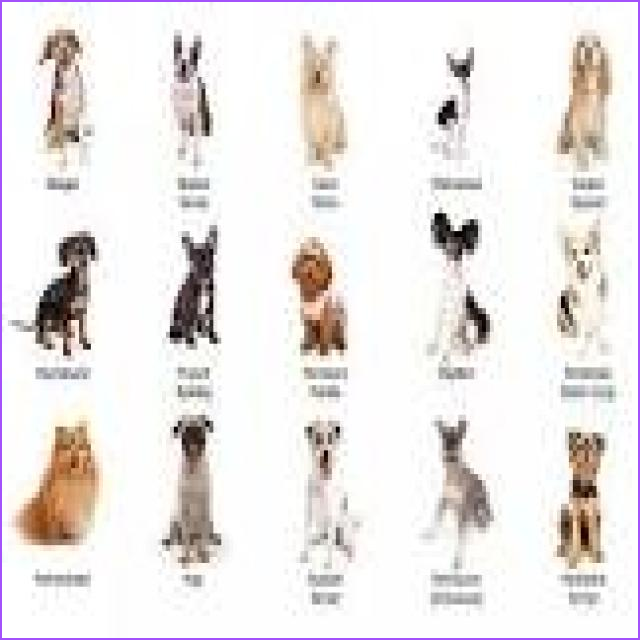


Predictions: ['dog']
Targets: ['dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


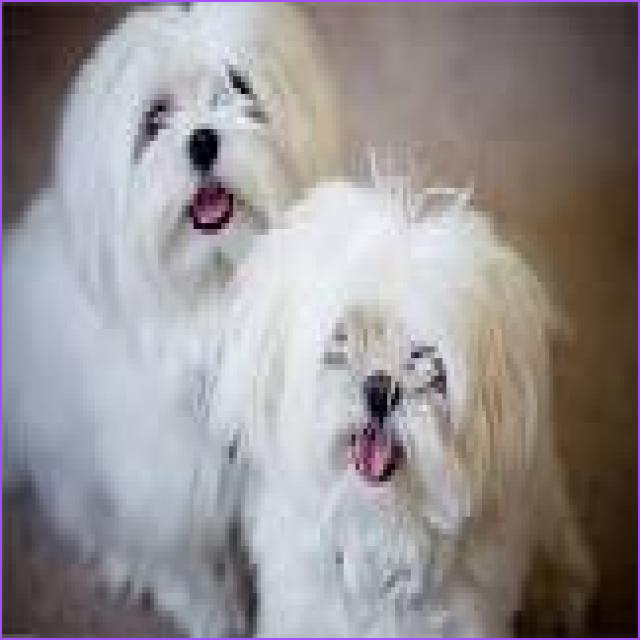


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


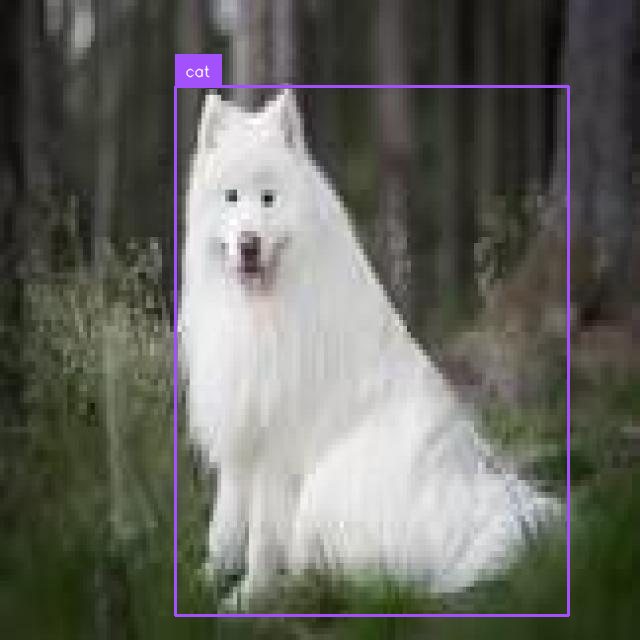


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


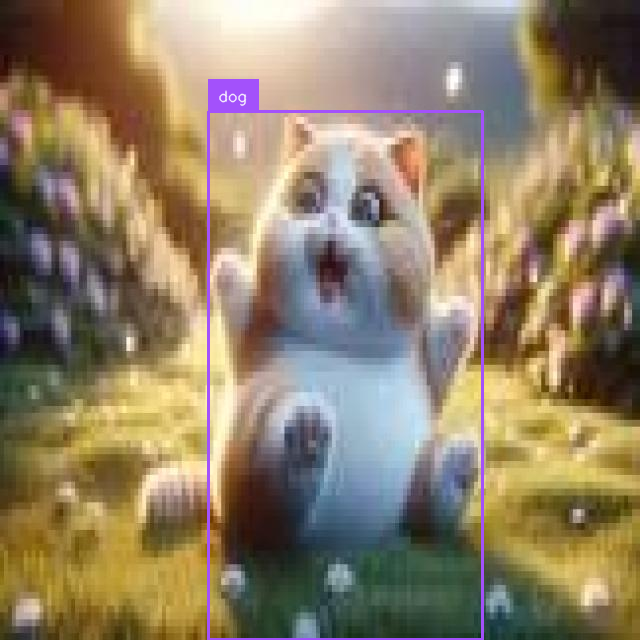


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


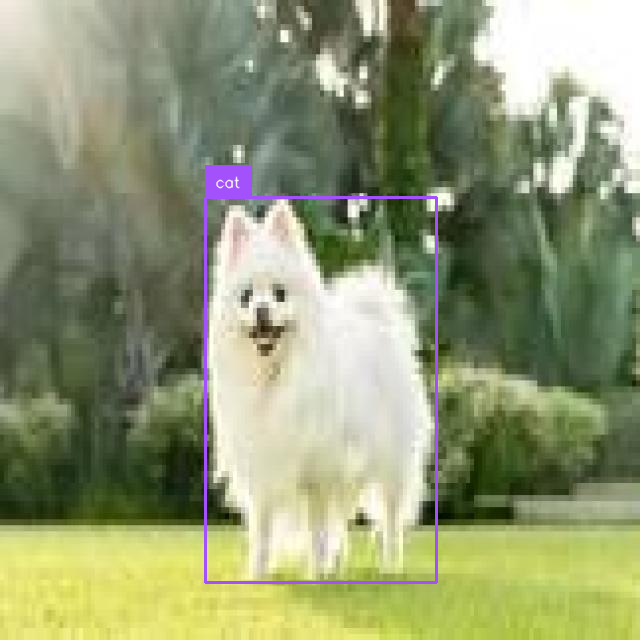


map50_95: 0.62
map50: 0.80
map75: 0.71


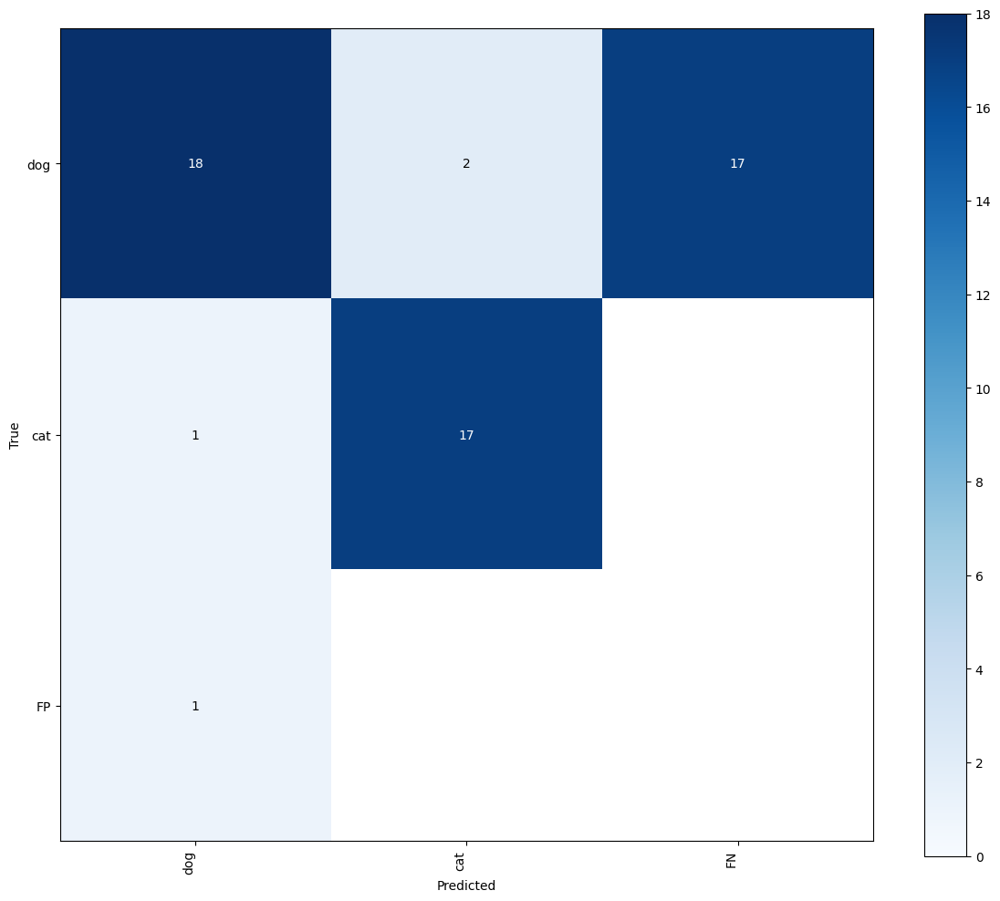

In [26]:
inference(peft_model, test_dataset, ["dog", "cat"])

Here, after finetuning the model is able to perform a little better for our use case. It now does not use any generic words to describe the object other than "dog" or "cat".

Still the model is not able to identify all the animals in an image if there are more than one keeping the value of false negatives high.

## Inference on Zero-Shot Test set

The images provided below are the ones that have differed from the ground truth. The predictions by model have been marked for better understanding. 

Predictions: ['dog']
Targets: ['dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


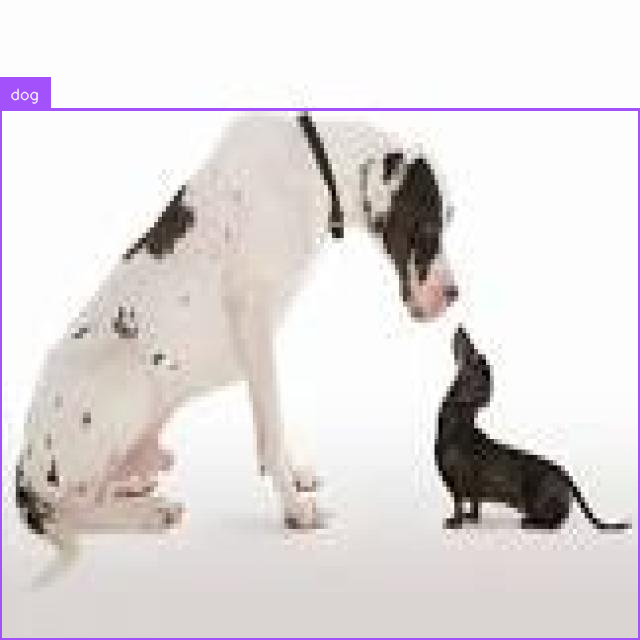


Predictions: ['animal']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


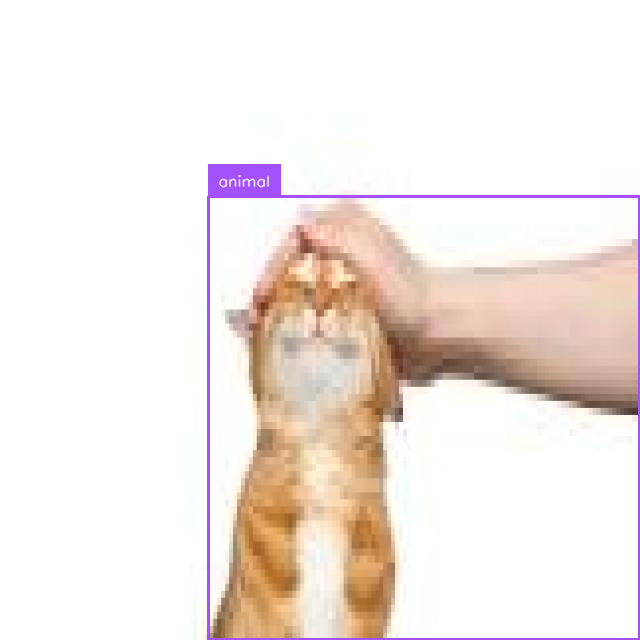


Predictions: ['dog']
Targets: ['dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


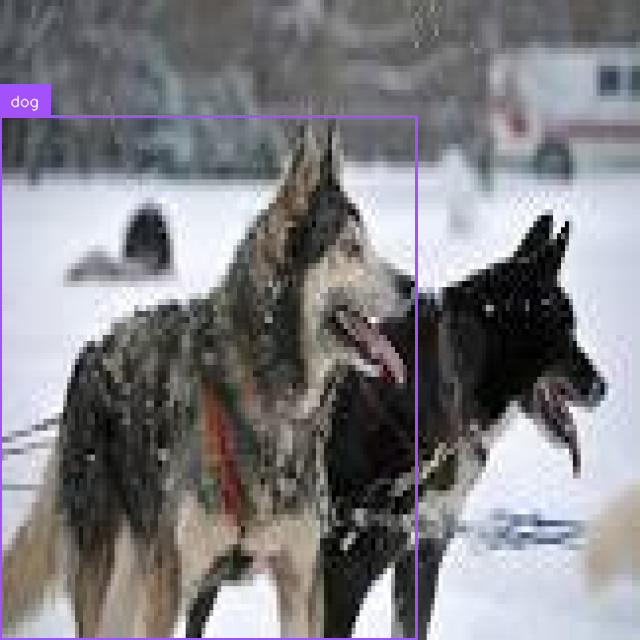


Predictions: ['cat']
Targets: ['cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


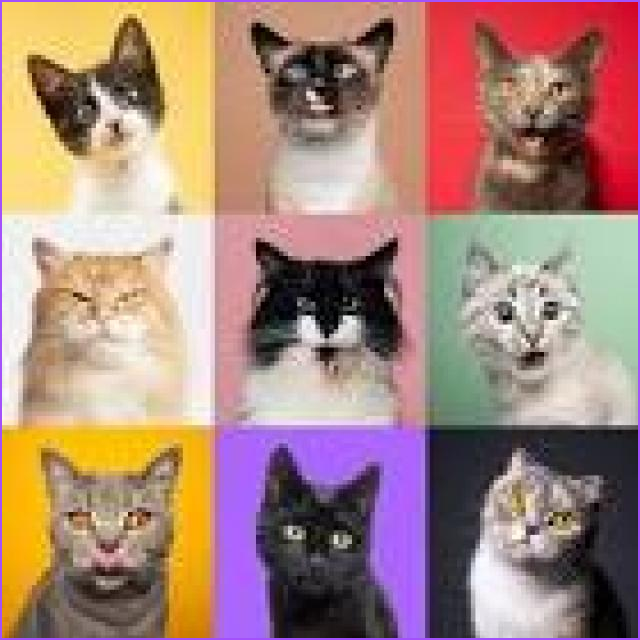


Predictions: ['cat']
Targets: ['cat', 'cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


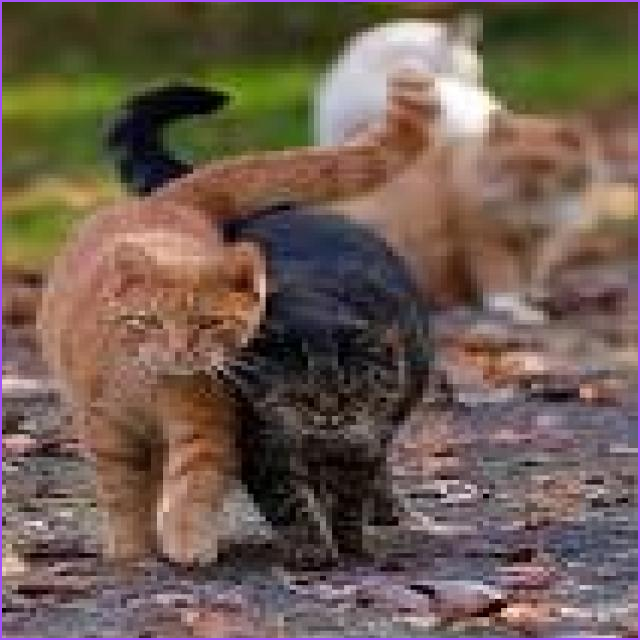


Predictions: ['dog']
Targets: ['dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog', 'dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


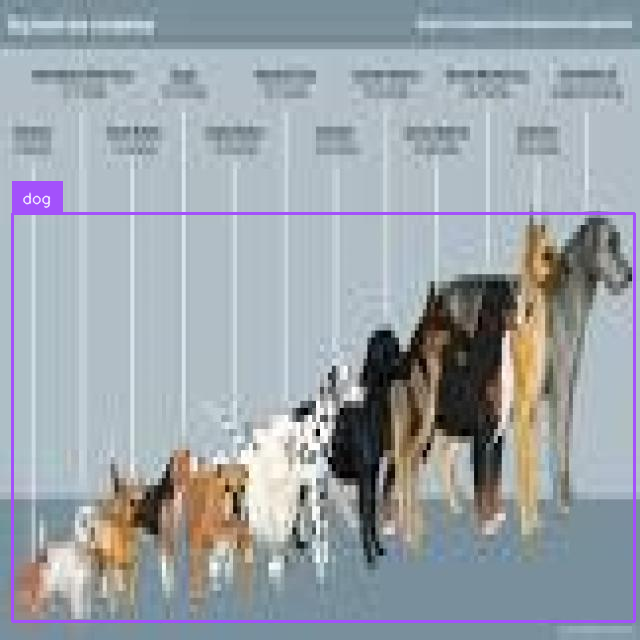


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


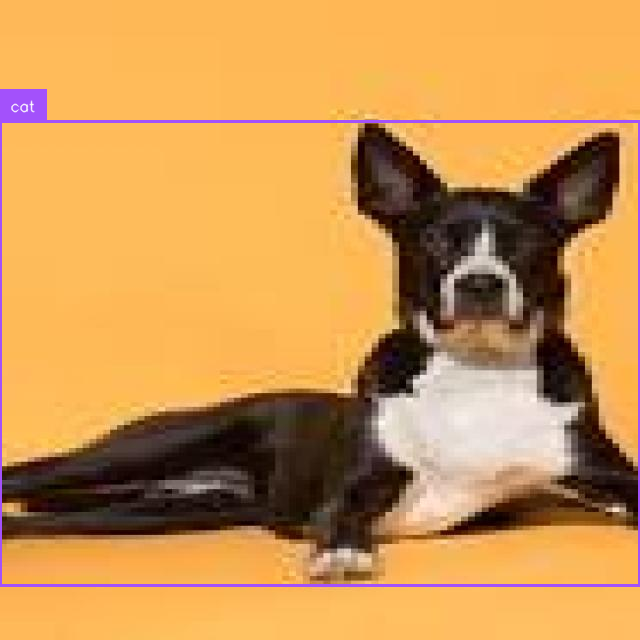


Predictions: ['cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat']
Targets: ['cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


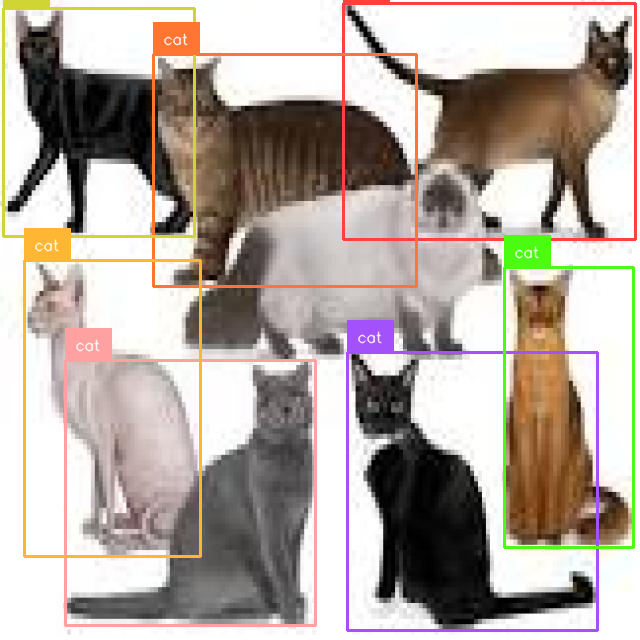


map50_95: 0.56
map50: 0.77
map75: 0.69


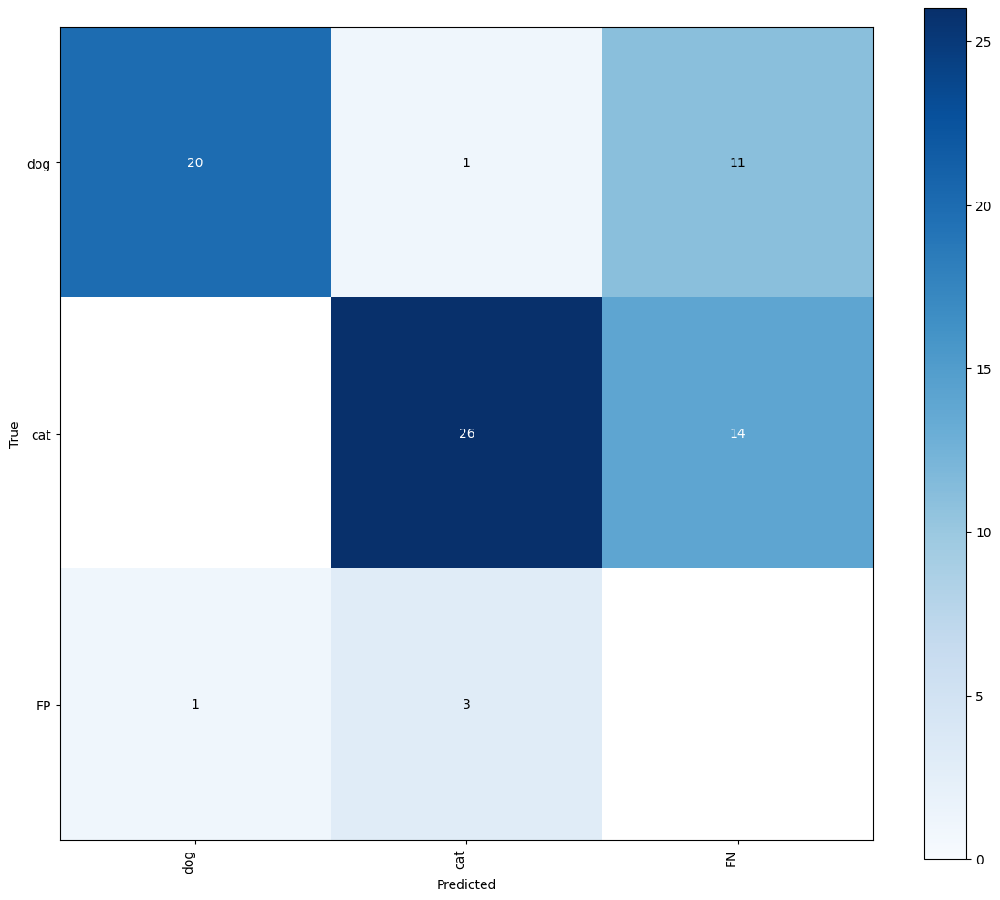

In [25]:
inference(peft_model, zero_shot_dataset, ["dog", "cat"])

This is the dataset over which we tested the zero-shot model.

The results seem to be worsen a lot after fine tuning. But it is the difference of just one image where after fine tuning model is not able to detect all the eight cats in a single image which it was able to do before. 

Now the model does not use any generic terms like "carnivore" to describe identified animal. 

# Reversing the labels

In [ ]:
rf = Roboflow(api_key="cRRTkEkCYliGBFa3bNTf")
project = rf.workspace("dhruv-gupta-dpgcz").project("florence2_fine_tuning-2")
version = project.version(2)
dataset = version.download("florence2-od")

In [31]:
train_dataset = DetectionDataset("Florence2_fine_tuning-2-2/train/annotations.jsonl", "Florence2_fine_tuning-2-2/train")
test_dataset = DetectionDataset("Florence2_fine_tuning-2-2/test/annotations.jsonl", "Florence2_fine_tuning-2-2/test")

train_loader = DataLoader(train_dataset, batch_size=6, collate_fn=collate_fn, num_workers=0, shuffle=True)


In [32]:
train_model(peft_model, train_loader, processor, 15, 5e-6)

This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
Training Epoch 1/15: 100%|██████████| 10/10 [00:14<00:00,  1.47s/it]


Average Training Loss: 5.900790882110596


Training Epoch 2/15: 100%|██████████| 10/10 [00:14<00:00,  1.48s/it]


Average Training Loss: 6.894452524185181


Training Epoch 3/15: 100%|██████████| 10/10 [00:14<00:00,  1.49s/it]


Average Training Loss: 5.668581795692444


Training Epoch 4/15: 100%|██████████| 10/10 [00:15<00:00,  1.51s/it]


Average Training Loss: 5.960174870491028


Training Epoch 5/15: 100%|██████████| 10/10 [00:15<00:00,  1.50s/it]


Average Training Loss: 5.353367900848388


Training Epoch 6/15: 100%|██████████| 10/10 [00:15<00:00,  1.51s/it]


Average Training Loss: 5.750427198410034


Training Epoch 7/15: 100%|██████████| 10/10 [00:15<00:00,  1.52s/it]


Average Training Loss: 5.192054414749146


Training Epoch 8/15: 100%|██████████| 10/10 [00:15<00:00,  1.52s/it]


Average Training Loss: 5.557248973846436


Training Epoch 9/15: 100%|██████████| 10/10 [00:15<00:00,  1.53s/it]


Average Training Loss: 5.531847620010376


Training Epoch 10/15: 100%|██████████| 10/10 [00:15<00:00,  1.53s/it]


Average Training Loss: 5.034390091896057


Training Epoch 11/15: 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]


Average Training Loss: 4.975637912750244


Training Epoch 12/15: 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]


Average Training Loss: 5.349721622467041


Training Epoch 13/15: 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]


Average Training Loss: 5.329412293434143


Training Epoch 14/15: 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]


Average Training Loss: 4.874416422843933


Training Epoch 15/15: 100%|██████████| 10/10 [00:15<00:00,  1.54s/it]

Average Training Loss: 4.947622060775757


## Inference on Test Dataset

The images provided below are the ones that have differed from the ground truth. The predictions by model have been marked for better understanding. 

Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


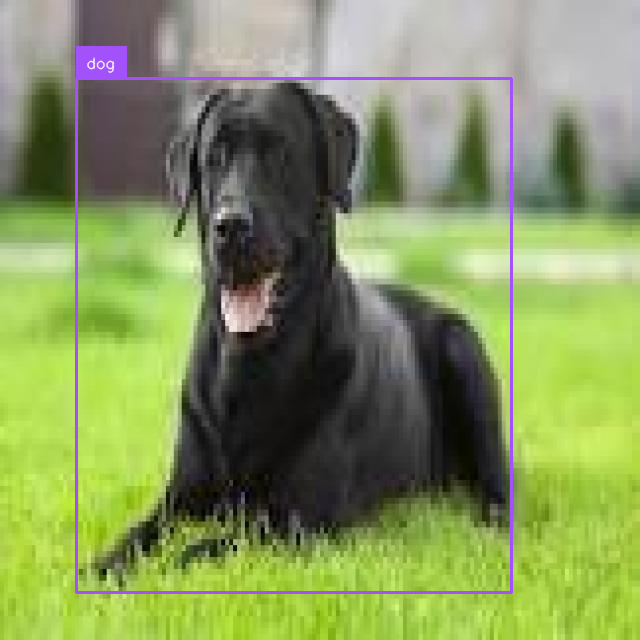


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


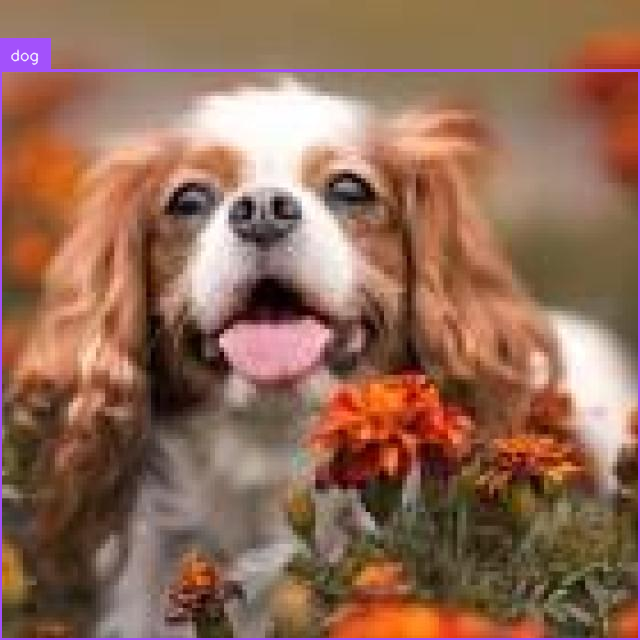


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


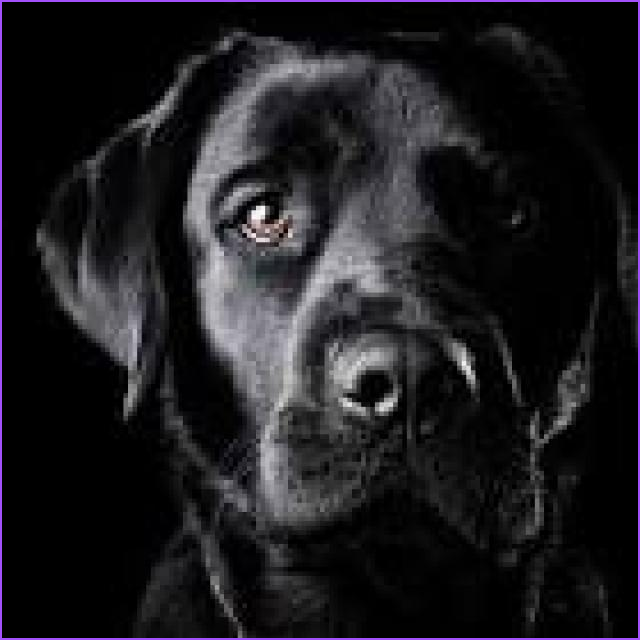


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


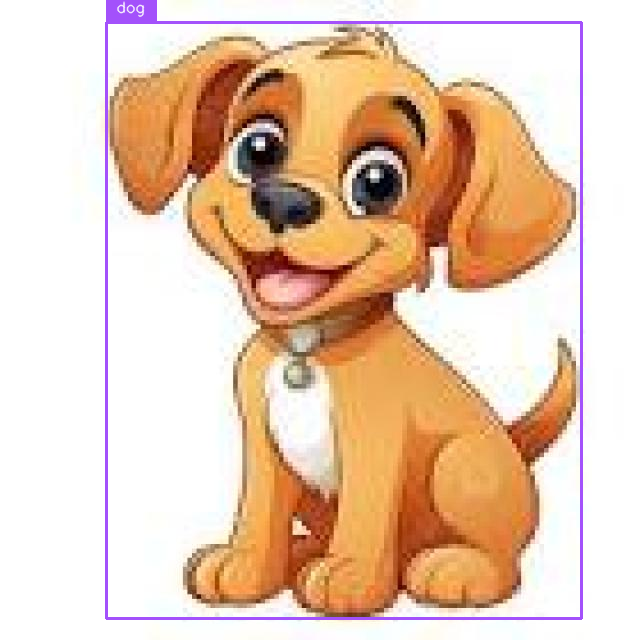


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


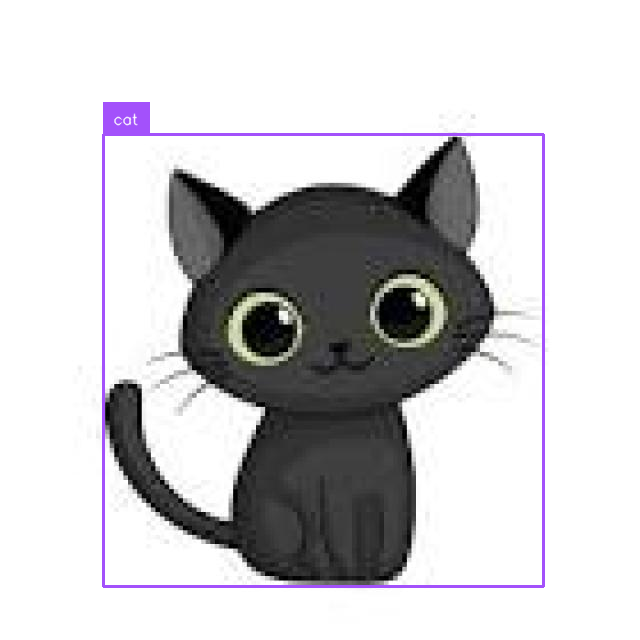


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


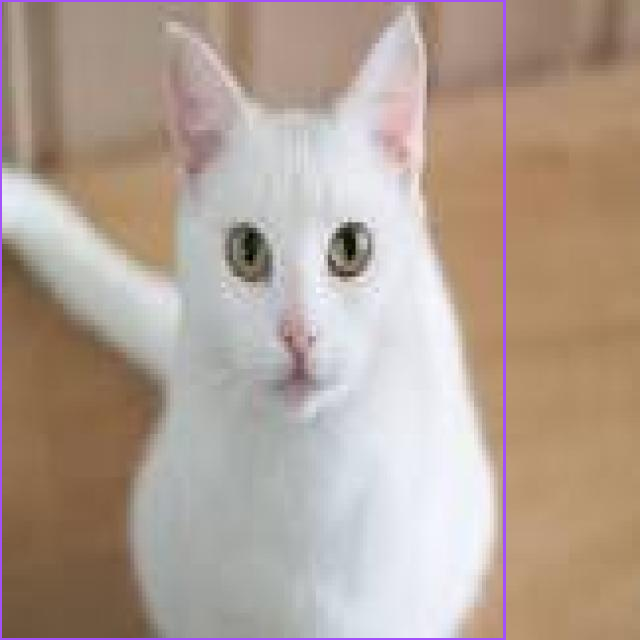


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


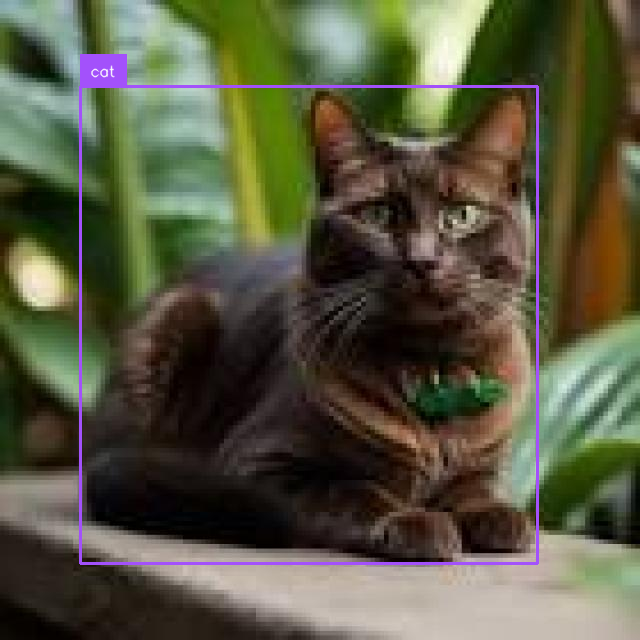


Predictions: ['window']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


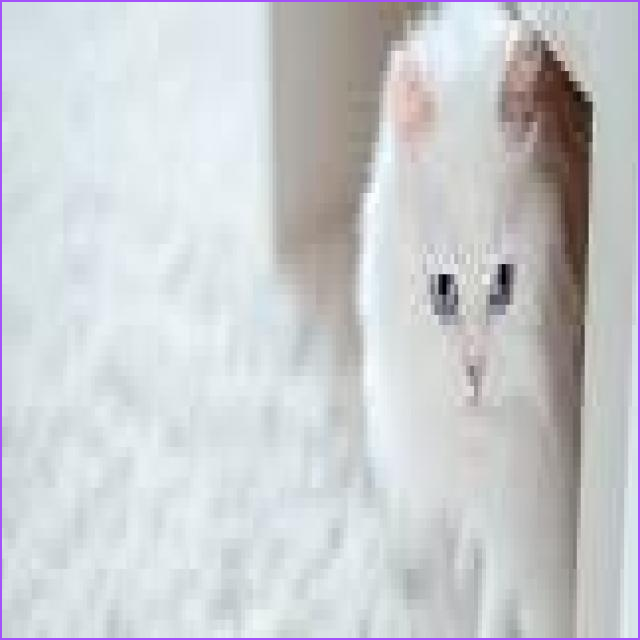


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


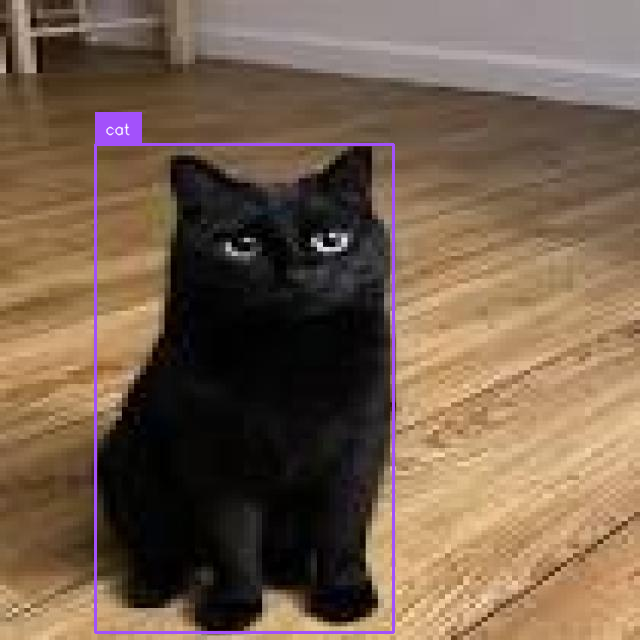


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


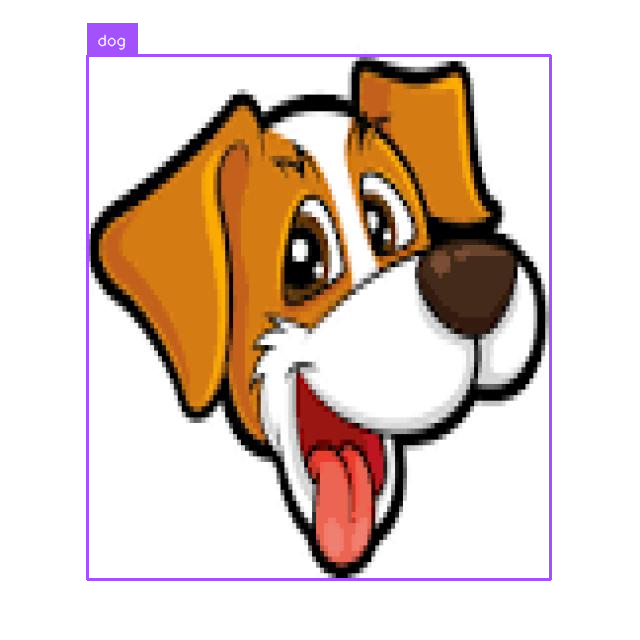


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


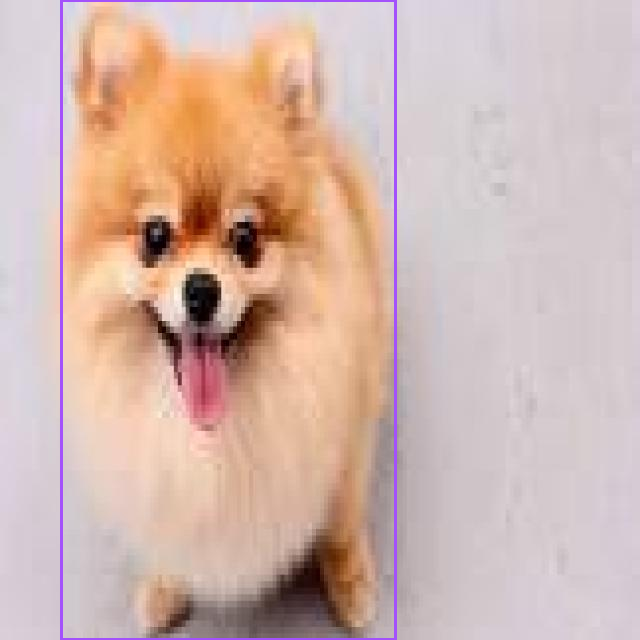


Predictions: ['dog']
Targets: ['cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat', 'cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


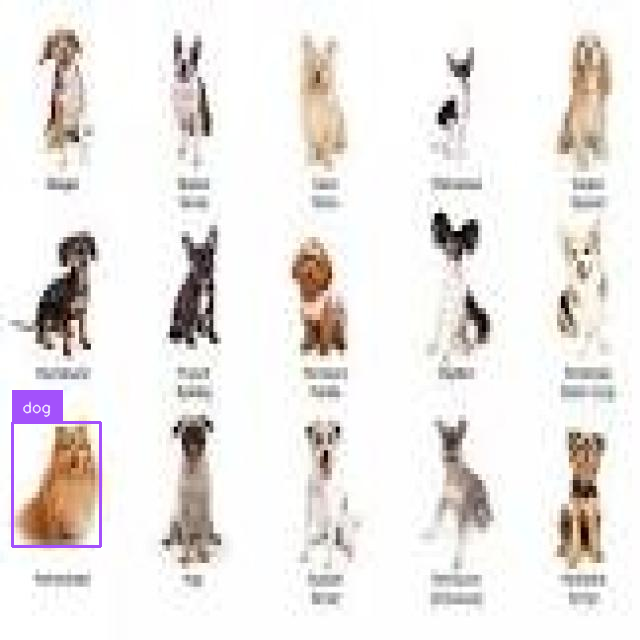


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


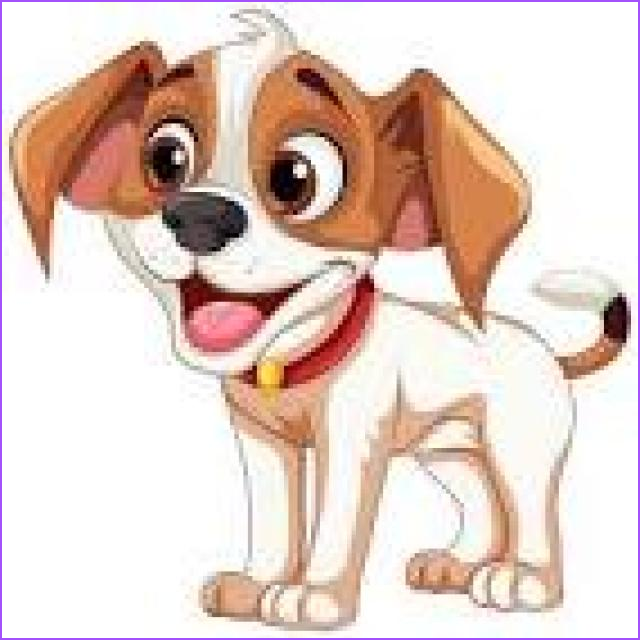


Predictions: ['carnivore']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


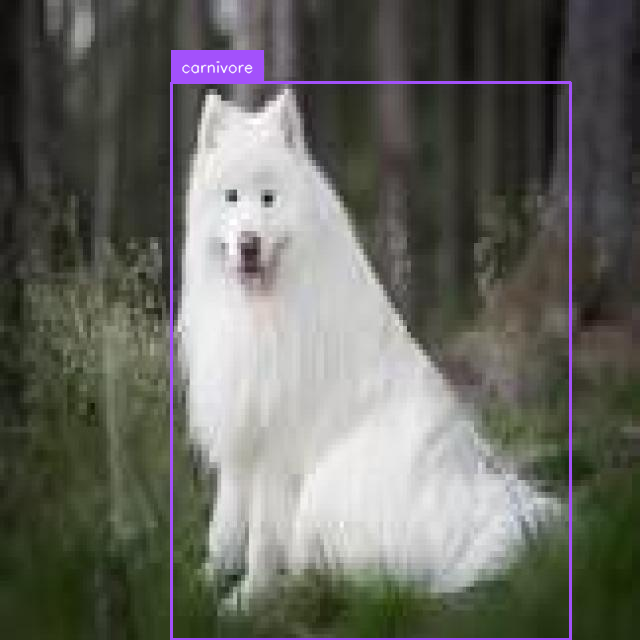


Predictions: ['carnivore']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


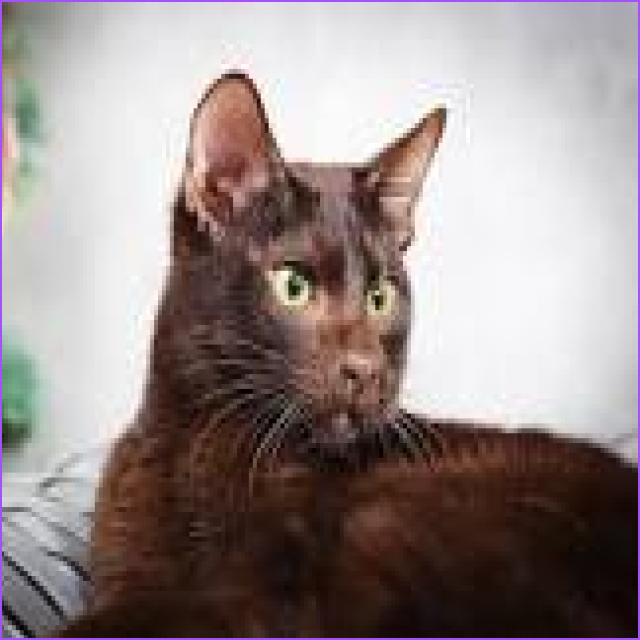


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


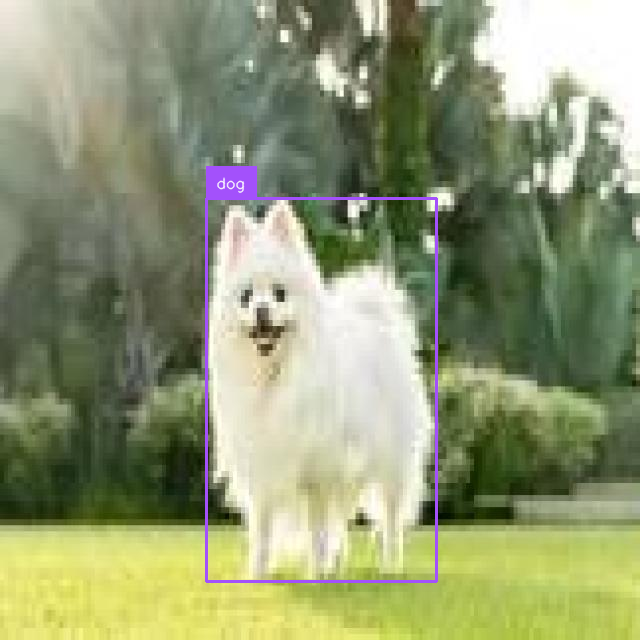


Predictions: ['animal']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


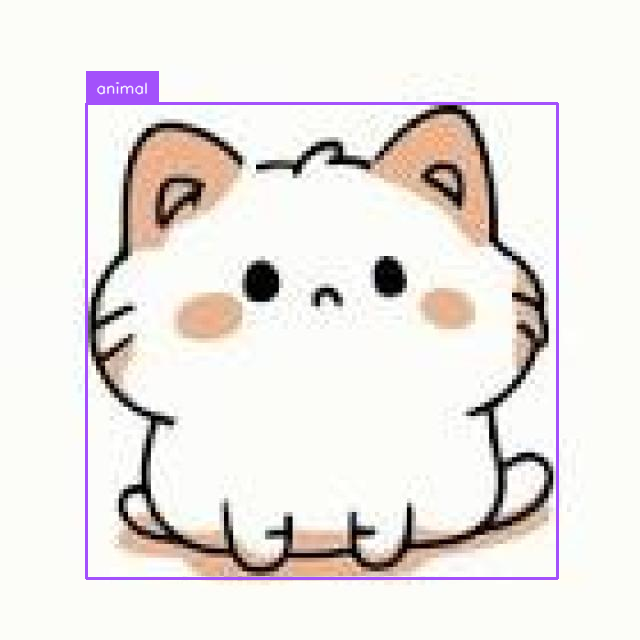


Predictions: ['dog']
Targets: ['cat', 'cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


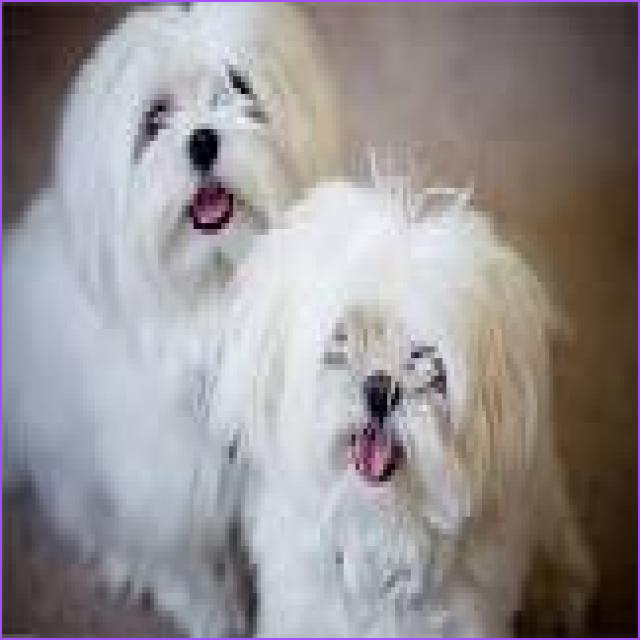


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


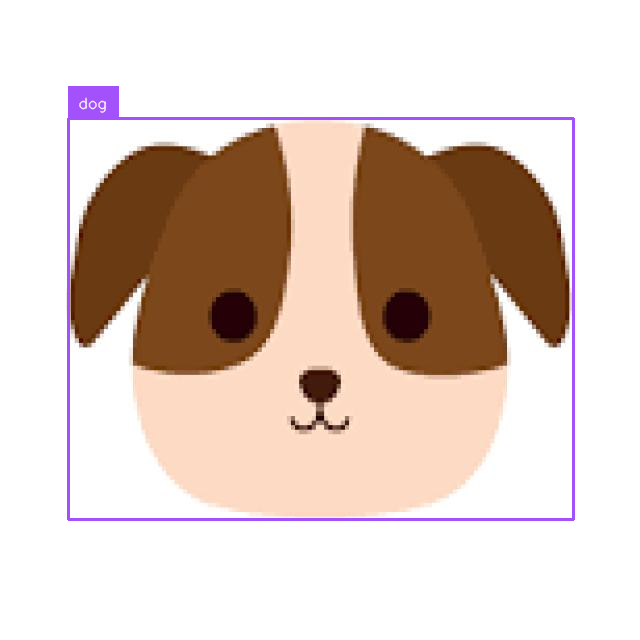


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


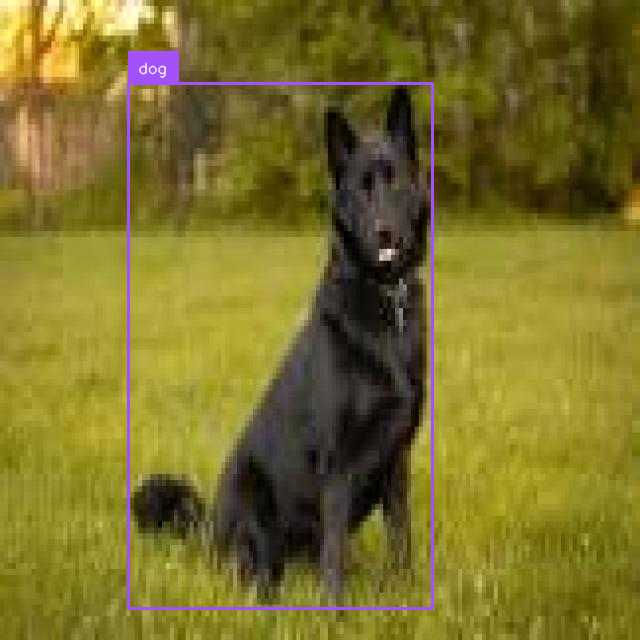


Predictions: ['carnivore']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


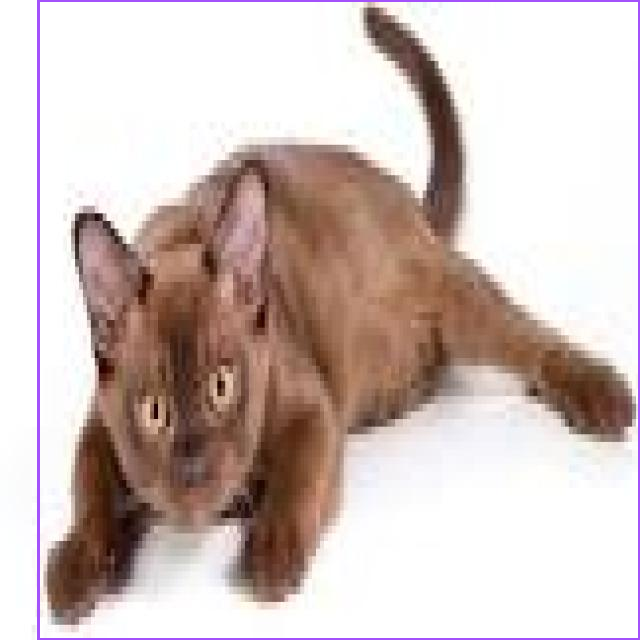


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


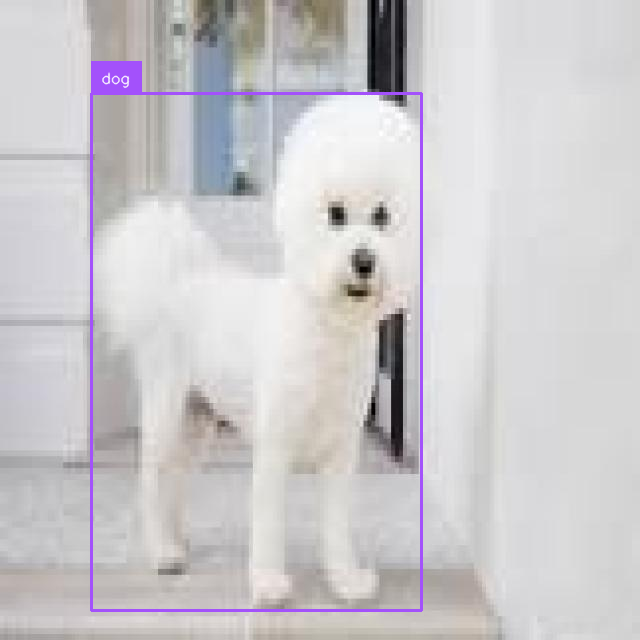


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


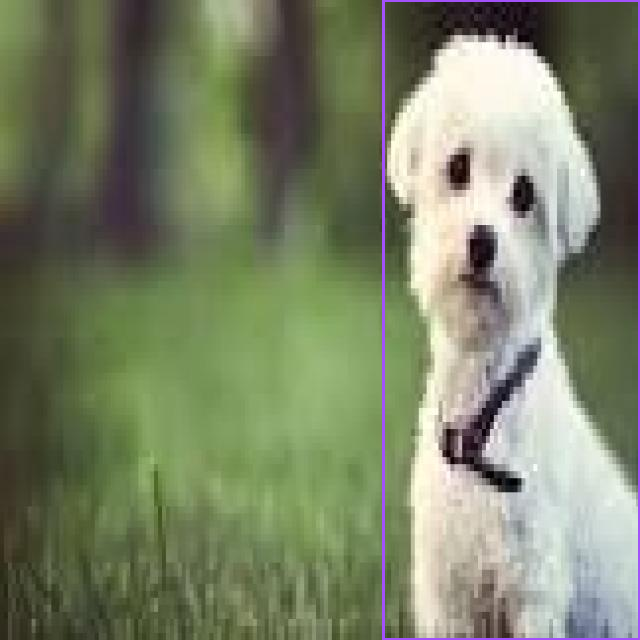


Predictions: ['bottle']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


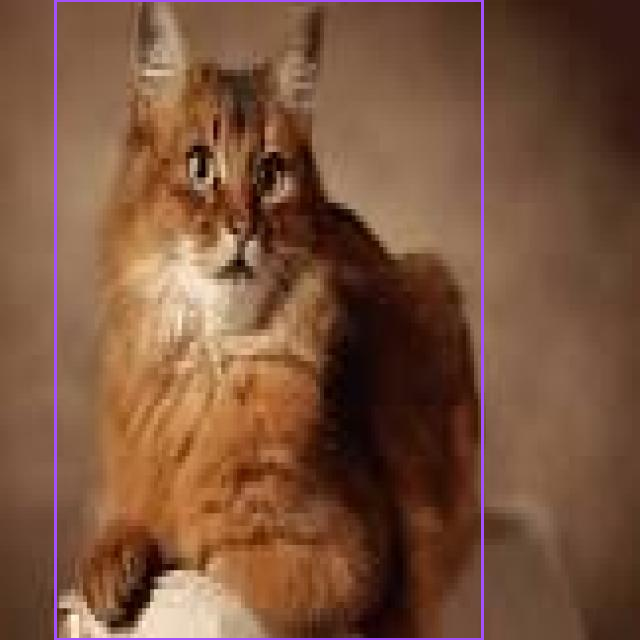


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


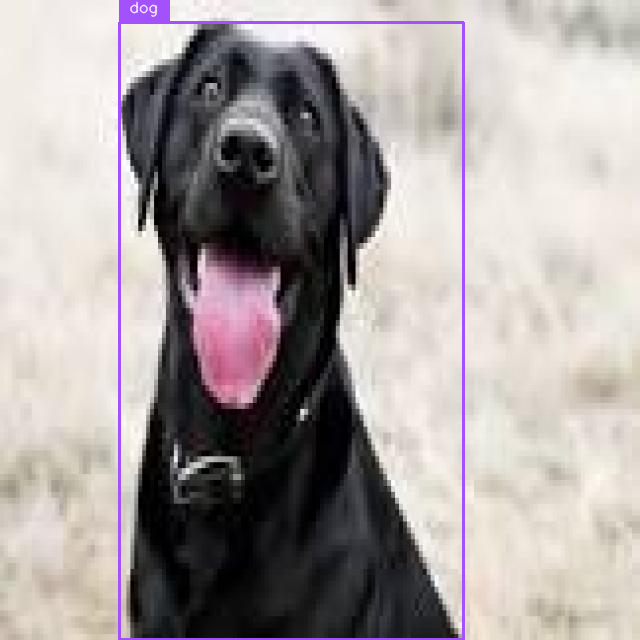


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


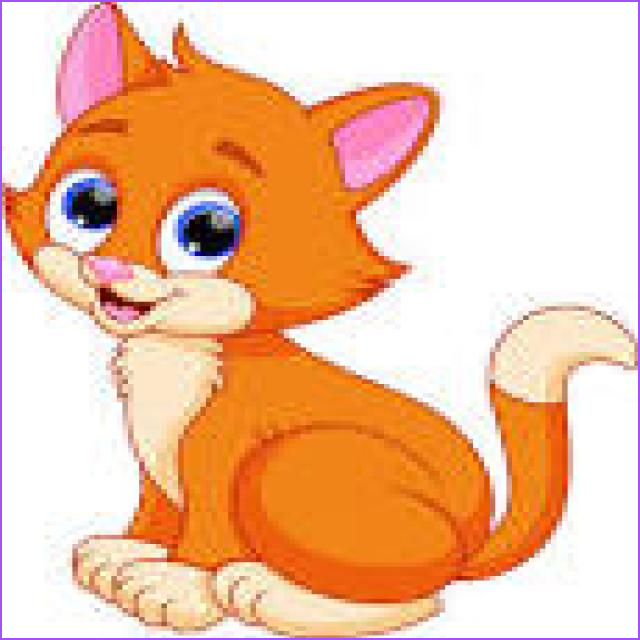


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


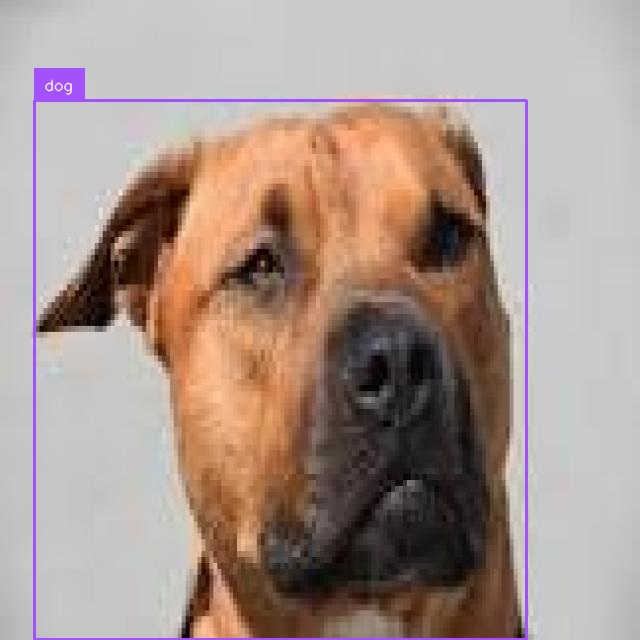


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


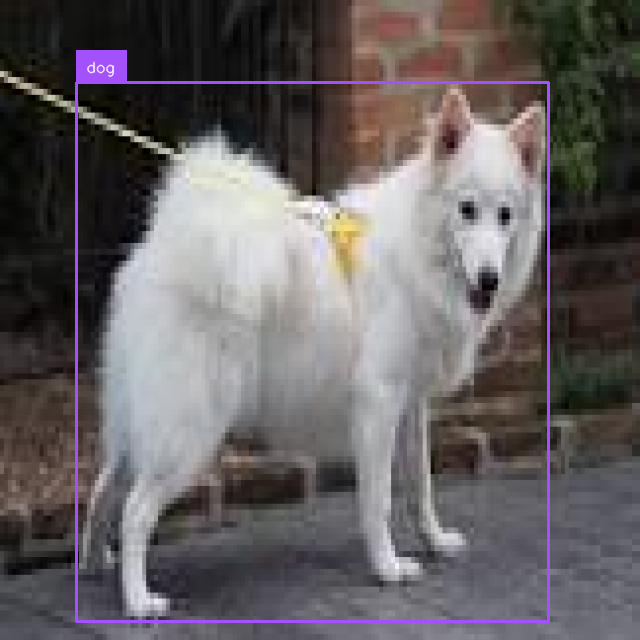


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


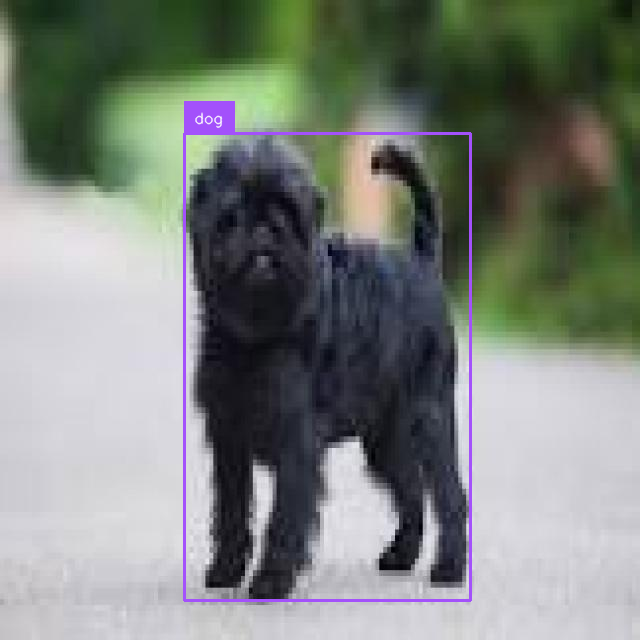


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


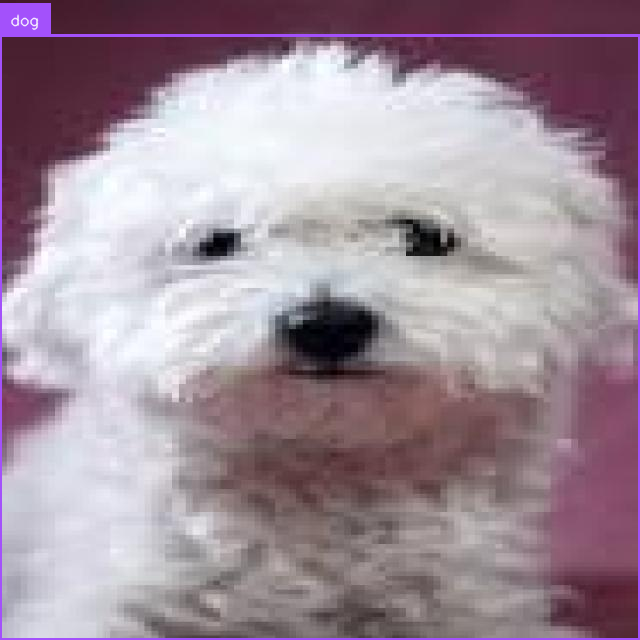


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


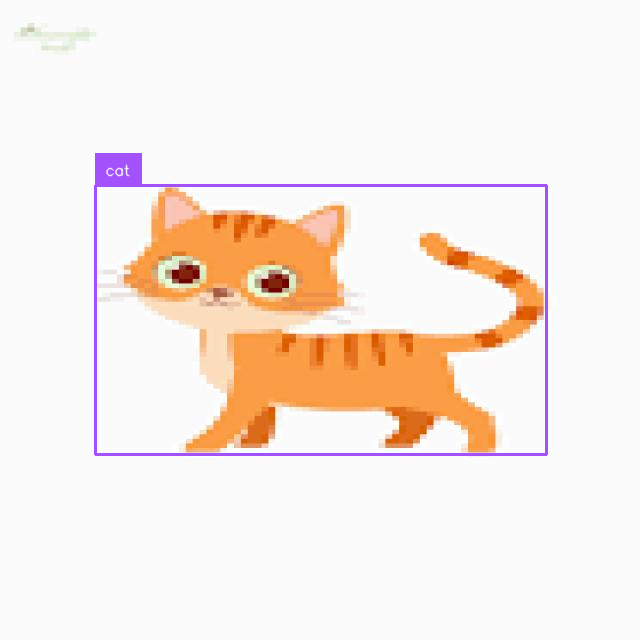


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


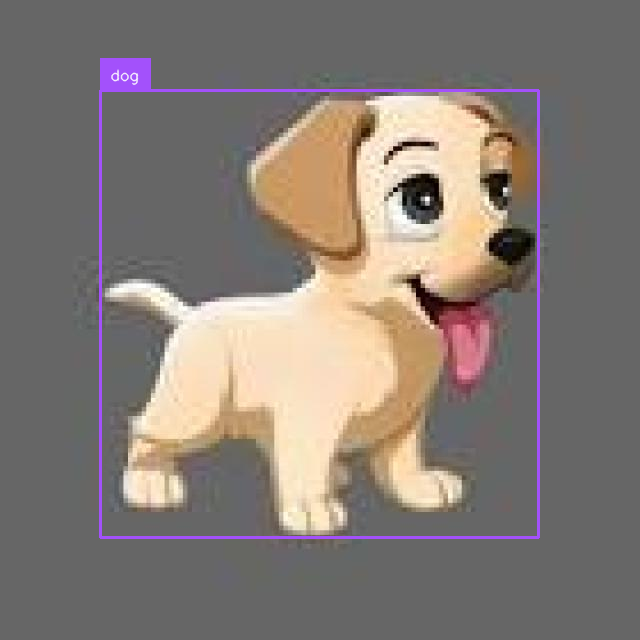


Predictions: ['dog']
Targets: ['cat']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


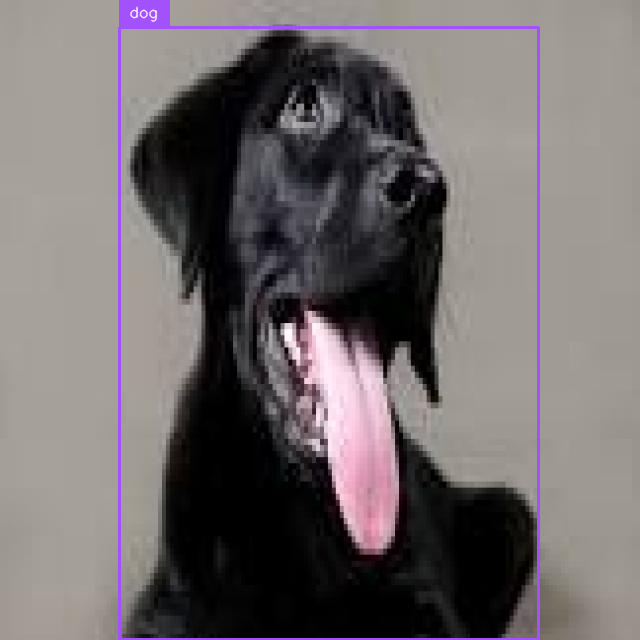


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


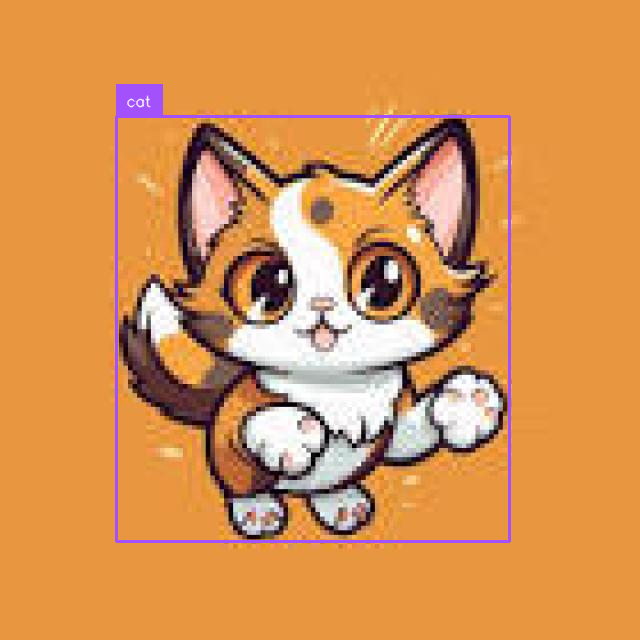


Predictions: ['cat']
Targets: ['dog']


BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.


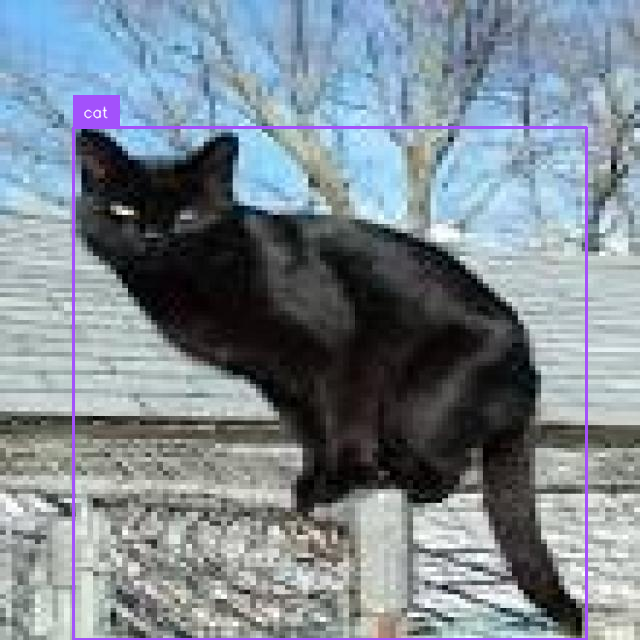


map50_95: 0.04
map50: 0.05
map75: 0.04


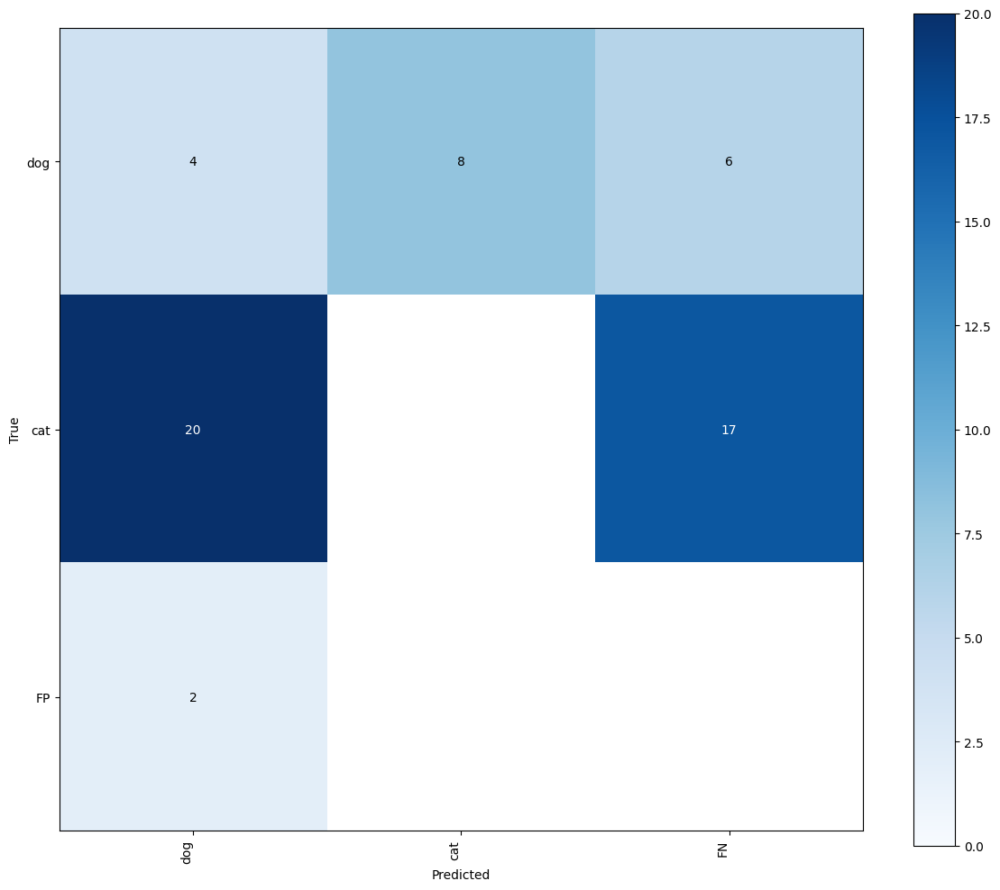

In [33]:
inference(peft_model, test_dataset, ["dog", "cat"])

Even after reversing the labels that model predicts the actual cats as cats that are labeled as dogs. There are a certain number of misses when more than one animal is present in a single image. 

The model also uses more generic terms as compared to previous cases like "carnivore" or "animal". 

Though the model has been trained on incorrect labels, it does not frequently make incorrect predictions. This indicates that the model has learned robust features that help it identify cats and dogs accurately, even with misleading training data.